### Подключение библиотек

In [1]:
import pandas as pd
import pickle
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

### Raw data
#### Dow Jones, FTSE 100, NASDAQ, S&P 500

In [2]:
tickers_dow = sorted(['UNH', 'MSFT', 'GS', 'HD', 'AMGN', 'MCD', 'CAT', 'CRM', 'BA', 'TRV', 'HON', 'V', 'AAPL', 'AXP', 'IBM', 'JPM', 'JNJ', 'WMT', 'PG', 'CVX', 'MRK', 'MMM', 'NKE', 'DIS', 'KO', 'DOW', 'CSCO', 'INTC', 'VZ', 'WBA'])

df_ftse = pd.read_csv("ftse.csv", header=None)
tickers_ftse = list(df_ftse[0])

df_nasdaq = pd.read_csv("nasdaq.txt", header=None)
tickers_nasdaq = list(df_nasdaq[0])

df_snp = pd.read_csv("snp.csv", header=None)
tickers_snp = list(df_snp[0])

tickers_dict = {
    "dow": tickers_dow,
    "ftse": tickers_ftse,
    "nasdaq": tickers_nasdaq,
    "snp": tickers_snp
}

pickle.dump(tickers_dict, open("tickers_dict.pkl", "wb"))

### Dataframe

In [3]:
list_dow = [["DOW", item] for item in tickers_dow]
list_ftse = [["FTSE", item] for item in tickers_ftse]
list_nasdaq = [["NASDAQ", item] for item in tickers_nasdaq]
list_snp = [["S&P", item] for item in tickers_snp]

In [4]:
df = pd.DataFrame(list_dow + list_ftse + list_nasdaq + list_snp, columns=["Index", "Ticker"])
df

,Index,Ticker
0,DOW,AAPL
1,DOW,AMGN
2,DOW,AXP
3,DOW,BA
4,DOW,CAT
...,...,...
722,S&P,MHK
723,S&P,PARA
724,S&P,VFC
725,S&P,FOX


In [5]:
df.to_csv("tickers_df.csv", index=False)  

### Выгрузка акций через yfinance

Выгрузим в периоде от 1 января 2020 года до 1 января 2024 года. Понятно, что некоторые акции могли не существовать в этот период.

В итоге мы получим матрицу $n \times m$, где $n~-$ количество дней, а $m~-$ количество акций

In [11]:
start_date = '2020-01-01'
end_date = '2024-01-01'

tickers = df['Ticker'].unique().tolist()
price_data = yf.download(tickers, start=start_date, end=end_date, auto_adjust=False)['Adj Close']

[*********************100%***********************]  608 of 608 completed

13 Failed downloads:
['PEAK', 'PXD', 'BDEV.L', 'SPLK', 'FLT', 'ICP.L', 'WRK', 'CPG']: YFTzMissingError('possibly delisted; no timezone found')
['FRES', 'SMDS.L', 'MRO', 'CTLT']: YFPricesMissingError('possibly delisted; no price data found  (1d 2020-01-01 -> 2024-01-01) (Yahoo error = "No data found, symbol may be delisted")')
['SPXSY']: YFPricesMissingError('possibly delisted; no price data found  (1d 2020-01-01 -> 2024-01-01) (Yahoo error = "Data doesn\'t exist for startDate = 1577854800, endDate = 1704085200")')


Посмотрим на наличие пропусков: сколько пропусков у каждой акции, и удалим акции с достаточно большим числом пропусков. 

In [12]:
cnt_nans = price_data.isna().sum()
print(cnt_nans)
filtered = cnt_nans[cnt_nans > 24]
filtered_columns = price_data[filtered.index].columns
print(filtered_columns)

Ticker
A        24
AAF.L    22
AAL      24
AAPL     24
ABBV     24
         ..
ZBH      24
ZBRA     24
ZION     24
ZS       24
ZTS      24
Length: 608, dtype: int64
Index(['ABNB', 'BDEV.L', 'CARR', 'CEG', 'CPG', 'CTEC', 'CTLT', 'DASH', 'DGE',
       'FLT', 'FRES', 'GEHC', 'GFS', 'HIK', 'ICP.L', 'KVUE', 'MNG', 'MRO',
       'OTIS', 'PEAK', 'PXD', 'RKT', 'SKG', 'SMDS.L', 'SPLK', 'SPXSY', 'VLTO',
       'WRK'],
      dtype='object', name='Ticker')


In [14]:
price_data = price_data.drop(columns=filtered_columns)

In [15]:
price_data

Ticker,A,AAF.L,AAL,AAPL,ABBV,ABT,ACGL,ACN,ADBE,ADI,...,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZS,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2020-01-02,82.885254,78.735954,28.982893,72.716064,71.589775,79.273941,41.268997,195.263611,334.429993,109.436226,...,53.112015,55.137981,52.434685,75.007889,92.652496,139.014786,259.140015,43.711163,47.330002,128.819458
2020-01-03,81.554466,78.436195,27.548195,72.009125,70.910263,78.307518,41.221451,194.938385,331.809998,107.509743,...,53.367443,54.694695,51.854439,75.449409,92.362320,138.651459,256.049988,43.094341,47.380001,128.838638
2020-01-06,81.795540,78.386238,27.219410,72.582916,71.469864,78.717796,41.383106,193.665421,333.709991,106.246635,...,53.290821,55.114655,52.139954,74.960938,92.307899,137.850128,258.010010,42.569202,48.700001,127.849518
2020-01-07,82.046265,79.235558,27.119778,72.241554,71.062149,78.280182,41.040779,189.484177,333.390015,108.663811,...,53.180119,54.663605,52.416264,74.679115,92.471130,137.729034,256.470001,42.310802,48.400002,128.281677
2020-01-08,82.856331,77.686806,27.737495,73.403656,71.565804,78.599281,40.631893,189.855881,337.869995,109.645233,...,53.129047,53.839249,52.968884,74.932739,92.634361,139.378220,247.639999,42.727581,50.750000,128.003174
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,138.080856,129.473770,14.310000,192.444595,148.079468,106.338722,70.214340,348.842224,598.750000,192.972641,...,58.772793,97.674706,33.840984,111.066040,126.863914,119.038551,269.410004,42.116348,221.679993,192.485916
2023-12-26,138.318298,NaN,14.110000,191.897873,147.773636,106.533791,69.900551,347.838318,598.260010,194.705582,...,58.952728,97.895149,34.148457,112.032341,127.117622,120.126839,275.500000,42.958672,224.589996,192.999252
2023-12-27,138.328201,129.773712,13.990000,191.997253,148.022125,107.079971,69.929077,348.222198,596.080017,195.175537,...,58.771282,97.435089,34.234940,112.781723,127.683632,119.839928,275.790009,42.604507,225.020004,194.381348


Заполним пропуски, используя forward fill и backward fill. Первый метод заполняет ближайшим предыдущим непустым значением, а второй метод заполняет следующим ближайшим непустым значением. Также удалим акции, которые полностью состоят из пропусков (они могли не торговаться в данный период)

In [16]:
price_data = price_data.replace([np.inf, -np.inf], np.nan)
price_data = price_data.fillna(method='ffill').fillna(method='bfill')
price_data = price_data.dropna(axis=1)
print(price_data.isna().sum())

Ticker
A        0
AAF.L    0
AAL      0
AAPL     0
ABBV     0
        ..
ZBH      0
ZBRA     0
ZION     0
ZS       0
ZTS      0
Length: 580, dtype: int64


/var/folders/61/yjmw6mls60x61r2qn_zv2m600000gn/T/ipykernel_9823/190848069.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  price_data = price_data.fillna(method='ffill').fillna(method='bfill')


Затем удалим активы, которые оставались константными на протяжение всего времени. Скорее всего они удалились при предыдущей очистке, но все равно. Они нам будут мешать, потому что планируется подсчет кореляции между разными активами, и для подсчета будет считаться стандартное отклонение, которое будет равно 0 и которое будет в знаменателе

In [17]:
constant_columns = price_data.columns[price_data.nunique() == 1]
print(constant_columns)
price_data = price_data.drop(columns=constant_columns)

Index([], dtype='object', name='Ticker')


In [14]:
# threshold = 0.2
# returns = price_data.pct_change()
# returns = returns.iloc[1:]
# zero_percentage = (returns == 0).sum() / len(returns)
# index_remove = zero_percentage[zero_percentage > threshold].index
# # filtered_portfolio_returns = returns.drop(columns=index_remove)
# index_remove

### Расчет метрик: равномерный бейзлайн $\\$

Каждая доля акций в портфеле будет составлять одинаковое значение.

Напомним, что price_data $\in R^{n \times m}$

Посчитаем матрицу returns $\in R^{(n - 1) \times m}$, где в $i$ строчке будет записано процентное изменение цены с $i$ до $i+1$

Затем посчитаем среднюю доходность за весь период у каждой акции и запишем в mean_returns $\in R^m$

Затем мы считаем скалярное произведение вектора весов и среднюю доходность, получим доходность всего портфеля, обозначим это как portfolio_returns

Затем посчитаем волатильность и индекс Шарпа:

1. Считается ковариационная матрица доходностей. Она показывает как доходность актива меняется относительно друг друга

2. Затем считается волатильность портфеля через матричный вид $w^t \Sigma w$, где $w~-$ вектор весов, а $\Sigma~-$ наша ковариационная матрица, где $\Sigma_{ij}$ означает ковариацию между $i$ и $j$ столбцом у матрицы returns. Если развернуть это формулу, то получим $\sum\limits_{i=1}^{m}\sum\limits_{j=1}^{m} w_i w_j \Sigma_{ij}$. И затем надо взять корень чтобы получить волатильность

3. Индекс шарпа с безрисковой ставкой 2%

In [18]:
returns = price_data.pct_change()
returns = returns.iloc[1:]

num_assets = price_data.shape[1]
weights = np.full(num_assets, 1 / num_assets)

mean_returns = returns.mean(axis=0)
portfolio_returns = np.dot(weights, mean_returns)

cov_matrix = returns.cov()
portfolio_volatility = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
risk_free_rate = 0.02
sharpe_ratio = (portfolio_returns - risk_free_rate) / portfolio_volatility

print(f"Средняя доходность портфеля: {portfolio_returns * 100}")
print(f"Волатильность портфеля: {portfolio_volatility}")
print(f"Коэффициент Шарпа: {sharpe_ratio:.2f}")

Средняя доходность портфеля: 0.061902086070227534
Волатильность портфеля: 0.014528314323365979
Коэффициент Шарпа: -1.33


### Случайный бейзлайн из равномерного распределения

Каждая доля будет генерироваться из равномерного распределения от $0$ до $1$

In [19]:
random_weights = np.random.rand(num_assets) 
random_weights /= random_weights.sum()

mean_returns = returns.mean(axis=0)
portfolio_returns = np.dot(random_weights, mean_returns)

cov_matrix = returns.cov()
portfolio_volatility = np.sqrt(np.dot(random_weights.T, np.dot(cov_matrix, random_weights)))
risk_free_rate = 0.02
sharpe_ratio = (portfolio_returns - risk_free_rate) / portfolio_volatility

print(f"Средняя доходность портфеля: {portfolio_returns * 100}")
print(f"Волатильность портфеля: {portfolio_volatility}")
print(f"Коэффициент Шарпа: {sharpe_ratio:.2f}")

Средняя доходность портфеля: 0.059544930431706465
Волатильность портфеля: 0.014412590583282692
Коэффициент Шарпа: -1.35


In [20]:
from scipy.linalg import eigh
import networkx as nx
import matplotlib.pyplot as plt

def build_weight_matrix(returns):
    # matrix = returns.to_numpy()
    # columns_with_nans = np.where(np.isnan(matrix).any(axis=0))[0]
    # print("NaN values:", columns_with_nans)
    # row_sums = returns.sum(axis=1)
    # print("Row sums:", row_sums)
    # print("Any NaN in row sums:", np.isnan(row_sums).any())
    # W = np.array(returns)
    # row_sums = W.sum(axis=1)
    # print("Row sums:", row_sums)
    # print("Data type of row sums:", row_sums.dtype)
    # constant_columns = returns.columns[returns.nunique() == 1]
    # print(constant_columns)
    corr = returns.corr().abs()
    np.fill_diagonal(corr.values, 0)
    return corr.values

def compute_laplacian_matrix(W):
    D = np.diag(W.sum(axis=1))
    L = D - W
    # print("W is", W)
    # print("D is", D)
    # print("Lap is", L)
    return L

def spectral_clustering(L):
    # print("L is", L)
    eigenvalues, eigenvectors = eigh(L, subset_by_index=[1, 1])
    fiedler_vector = eigenvectors[:, 0]

    cluster_1 = np.where(fiedler_vector > 0)[0]
    cluster_2 = np.where(fiedler_vector <= 0)[0]
    return cluster_1, cluster_2

def allocate_capital_between_clusters(num_clusters, method="equal"):
    if method == "equal":
        weights = np.ones(num_clusters) / num_clusters
    elif method == "hierarchical":
        weights = 1 / (2 ** np.arange(1, num_clusters + 1))
        weights /= weights.sum()
    else:
        raise ValueError("Unknown allocation method")
    return weights

def allocate_within_cluster(cluster, total_weight):
    num_assets = len(cluster)
    return np.full(num_assets, total_weight / num_assets)

def recursive_clustering(W, num_clusters):
    clusters = [np.arange(W.shape[0])]

    while len(clusters) < num_clusters:
        largest_cluster_idx = np.argmax([len(cluster) for cluster in clusters])
        largest_cluster = clusters.pop(largest_cluster_idx)

        sub_W = W[np.ix_(largest_cluster, largest_cluster)]
        sub_L = compute_laplacian_matrix(sub_W)

        cluster_1, cluster_2 = spectral_clustering(sub_L)

        clusters.append(largest_cluster[cluster_1])
        clusters.append(largest_cluster[cluster_2])

    return clusters

def visualize_clusters(W, clusters):
    G = nx.Graph()
    num_nodes = W.shape[0]

    for i in range(num_nodes):
        G.add_node(i)

    for i in range(num_nodes):
        for j in range(i + 1, num_nodes):
            if W[i, j] > 0:
                G.add_edge(i, j, weight=W[i, j])

    cluster_colors = []
    for i, cluster in enumerate(clusters):
        cluster_colors.extend([i] * len(cluster))

    pos = nx.spring_layout(G)
    nx.draw(G, pos, with_labels=True, node_color=cluster_colors, cmap=plt.cm.tab10, node_size=500, edge_color="gray")
    plt.show()

def portfolio_optimization(price_data, num_clusters=2, method="equal", visualize=False):
    returns = price_data.pct_change().iloc[1:]

    W = build_weight_matrix(returns)
    # W2 = np.array(W)
    # print("W2 is", W2)
    # row_sums = W2.sum(axis=1)
    # print("Row sums:", row_sums)
    # print("Data type of row sums:", row_sums.dtype)
    
    clusters = recursive_clustering(W, num_clusters)

    if visualize:
        visualize_clusters(W, clusters)

    cluster_weights = allocate_capital_between_clusters(len(clusters), method)

    final_weights = np.zeros(W.shape[0])
    for i, cluster in enumerate(clusters):
        weights_cluster = allocate_within_cluster(cluster, cluster_weights[i])
        final_weights[cluster] = weights_cluster

    return final_weights

In [21]:
np.random.seed(42)
# price_data = pd.DataFrame(np.random.rand(10000, 600) * 100)

num_clusters = 20
final_weights = portfolio_optimization(price_data, num_clusters=num_clusters, method="hierarchical", visualize=False)

print("Финальное распределение капитала по активам:")
print(final_weights)

Финальное распределение капитала по активам:
[2.64909785e-08 1.39509062e-04 6.83638155e-09 2.50400880e-05
 1.05233128e-06 1.05233128e-06 6.83638155e-09 6.83638155e-09
 2.50400880e-05 2.64909785e-08 6.83638155e-09 6.83638155e-09
 2.64909785e-08 4.00641408e-04 4.00641408e-04 6.83638155e-09
 6.83638155e-09 1.31968031e-05 6.83638155e-09 6.83638155e-09
 6.83638155e-09 4.00641408e-04 2.64909785e-08 2.64909785e-08
 6.83638155e-09 6.83638155e-09 2.64909785e-08 6.83638155e-09
 2.50400880e-05 6.83638155e-09 1.05233128e-06 6.83638155e-09
 1.05233128e-06 2.50400880e-05 2.50400880e-05 2.50400880e-05
 1.39509062e-04 6.83638155e-09 6.83638155e-09 3.05176072e-05
 6.83638155e-09 6.83638155e-09 6.83638155e-09 6.83638155e-09
 8.71931635e-06 1.05233128e-06 2.29779631e-04 5.20833830e-04
 6.83638155e-09 2.64909785e-08 6.83638155e-09 4.00641408e-04
 2.50400880e-05 6.83638155e-09 2.50400880e-05 2.50400880e-05
 6.83638155e-09 5.20833830e-04 6.83638155e-09 2.50400880e-05
 5.20833830e-04 6.25000596e-03 1.0523312

In [22]:
mean_returns = returns.mean(axis=0)
portfolio_returns = np.dot(final_weights, mean_returns)

cov_matrix = returns.cov()
portfolio_volatility = np.sqrt(np.dot(final_weights.T, np.dot(cov_matrix, final_weights)))
risk_free_rate = 0.02
sharpe_ratio = (portfolio_returns - risk_free_rate) / portfolio_volatility

print(f"Средняя доходность портфеля: {portfolio_returns * 100}")
print(f"Волатильность портфеля: {portfolio_volatility}")
print(f"Коэффициент Шарпа: {sharpe_ratio:.2f}")

Средняя доходность портфеля: 0.12773494751592493
Волатильность портфеля: 0.029417038160567902
Коэффициент Шарпа: -0.64


In [23]:
def plot_cumulative_returns(stocks=None):
    if stocks != None:
        data = price_data[stocks]
    else:
        data = price_data
    returns = data.pct_change()
    returns = returns.iloc[1:]

    port_comps_rets_cumprod = returns.add(1).cumprod().sub(1)*100

    fig = px.line(port_comps_rets_cumprod,
                x=port_comps_rets_cumprod.index,
                y=port_comps_rets_cumprod.columns,
                title='Cumulative Returns of Portfolio Stocks (2020-2024)')

    fig.update_xaxes(title_text='Date')
    fig.update_yaxes(title_text='Cumulative Return in %')
    fig.update_layout(
        width=1600,
        height=800
    )

    fig.show()
plot_cumulative_returns()

Разделим выборку на обучающую и тестовую. Обучающая будет включать в себя данные до 30 июля 2022 года, а тестовая$~-$ остальное. Исходя из обучающей выборке посчитаем параметры $\mu$ и $\Sigma$, которые обозначают вектор ожидаемых доходностей и ковариационная матрица доходностей соответственно.

In [25]:
from pypfopt import risk_models
from pypfopt import expected_returns
from pypfopt.expected_returns import ema_historical_return
from pypfopt.risk_models import exp_cov
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt.plotting import plot_efficient_frontier
from pypfopt.plotting import plot_weights
from pypfopt.cla import CLA

train = returns[:'2022-07-30']
test = returns['2022-07-31':]

mu = expected_returns.ema_historical_return(train, returns_data = True, span = 500)
Sigma = risk_models.exp_cov(train, returns_data = True, span = 180)
print('mu:', mu)
print('Sigma:', Sigma)

mu: Ticker
A        0.128097
AAF.L    0.711704
AAL     -0.085031
AAPL     0.286250
ABBV     0.267101
           ...   
ZBH     -0.110210
ZBRA    -0.038404
ZION     0.109964
ZS       0.075670
ZTS      0.078487
Name: 2022-07-29 00:00:00, Length: 580, dtype: float64
Sigma: Ticker         A     AAF.L       AAL      AAPL      ABBV       ABT      ACGL  \
Ticker                                                                         
A       0.115434  0.012378  0.062032  0.069778  0.015702  0.058894  0.033010   
AAF.L   0.012378  0.164721  0.052065  0.022586  0.006062  0.014763  0.033484   
AAL     0.062032  0.052065  0.371159  0.115650  0.010517  0.063906  0.062849   
AAPL    0.069778  0.022586  0.115650  0.109509  0.011606  0.049185  0.032193   
ABBV    0.015702  0.006062  0.010517  0.011606  0.049675  0.024530  0.013787   
...          ...       ...       ...       ...       ...       ...       ...   
ZBH     0.048398  0.016207  0.090429  0.050262  0.015999  0.044138  0.033783   
ZBRA    0

Затем подадим эти два параметра в класс EfficientFrontier из библиотеки PyPortfolioOpt и посмотрим на метрики и распределение весов, когда мы минимизируем волатильность

{'FLTR': 0.9101389666470162, 'EDV': 0.0195712989323066, 'BAX': 0.0104600339805878, 'BA.L': 0.0092428676316931, 'UU.L': 0.0089884647644322, 'ULVR.L': 0.0085137510662568, 'PSON.L': 0.0083651629216265, 'LSEG.L': 0.0079274697695703, 'SVT': 0.0078987207277881, 'BATS.L': 0.0038320473214609, 'CF': 0.0027496223918453, 'AV.L': 0.0018467357707409, 'JNJ': 0.0014835079527088, 'CME': 0.0014337493243107, 'BNZL.L': 0.0007296232927723, 'PHNX.L': 0.0001900273656135, 'K': 1.6172034284e-06, 'BEZ.L': 1.0008710829e-06, 'GIS': 7.282899562e-07, 'KHC': 6.081948304e-07, 'CAG': 5.086485911e-07, 'BT-A.L': 4.185062984e-07, 'NEM': 3.359562875e-07, 'CPB': 3.34714304e-07, 'HRL': 3.109209803e-07, 'SJM': 2.624244061e-07, 'BKY.L': 1.831052362e-07, 'NOC': 9.21135929e-08, 'WEC': 8.93701868e-08, 'CHD': 6.86721998e-08, 'KR': 6.03897196e-08, 'MRK': 5.50063781e-08, 'DUK': 5.18744579e-08, 'LMT': 5.02245268e-08, 'IMB.L': 2.01731275e-08, 'HSBA.L': 1.01226419e-08, 'D': -1.85599961e-08, 'KMB': -2.97541862e-08, 'ABBV': -6.34601602

(np.float64(-0.0027708874058246825),
 np.float64(0.025253212430335202),
 np.float64(-3.6736271736416573))

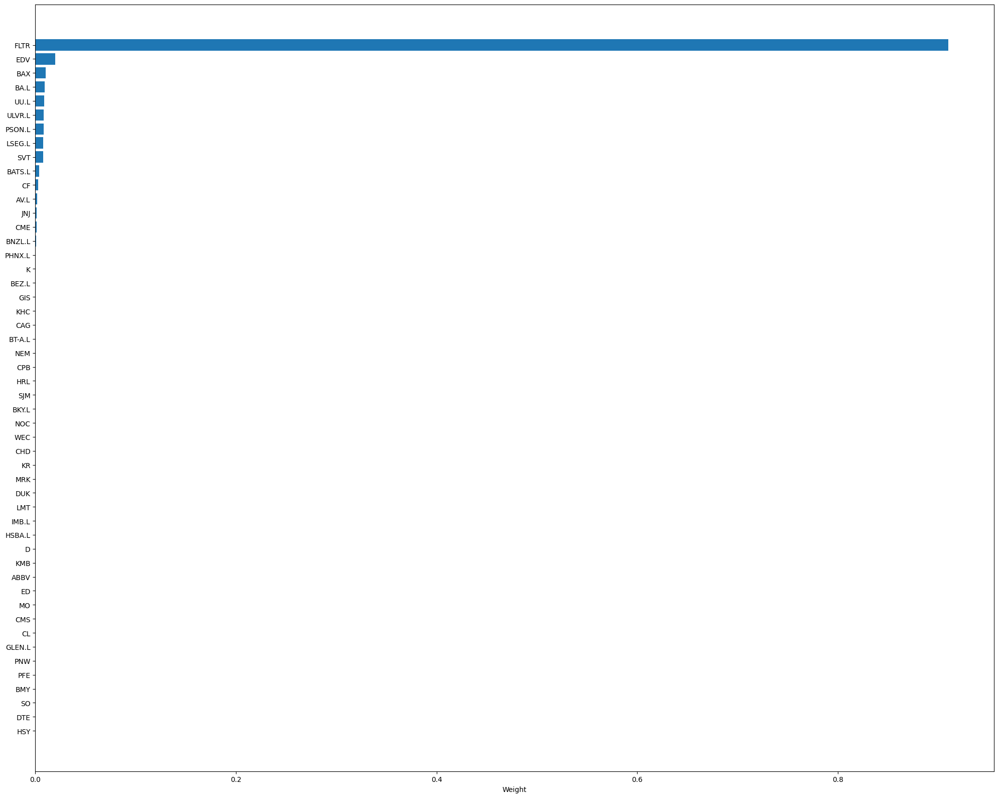

In [26]:
ef = EfficientFrontier(mu, Sigma)
raw_weights_minvar_exp = ef.min_volatility()

sorted_weights = {k: v for k, v in sorted(raw_weights_minvar_exp.items(), key=lambda item: item[1], reverse=True)}
top_50_weights = dict(list(sorted_weights.items())[:50])

print(top_50_weights)
plt.figure(figsize=(20, 16))
plot_weights(top_50_weights)
min_vol_ret = ef.portfolio_performance()[0]
min_vol_vol = ef.portfolio_performance()[1]
ef.portfolio_performance(verbose=True, risk_free_rate=0.09)

Аналогично сделаем с максимизацией соотношения Шарпа. И, действительно, у нас волатильность стала сильно выше по сравнению с предыдущим методом, который минимизирует волатильность

{'MCK': 0.2336708951863562, 'K': 0.1177298890569766, 'ENPH': 0.1123264852666228, 'EQT': 0.0845827093405441, 'BA.L': 0.0792890542449441, 'LLY': 0.0768963598872951, 'AAF.L': 0.0727311366893772, 'OXY': 0.0540667706802582, 'FRAS.L': 0.0492565413264201, 'SVT': 0.0459880238822076, 'BEZ.L': 0.0421418708119281, 'BKY.L': 0.0309415534169006, 'III': 0.0155092099144987, 'UU.L': 0.0003457053185564, 'PSON.L': -2.4689962422e-06, 'ABBV': -2.4866344648e-06, 'CF': -3.091075536e-06, 'EDV': -3.1439000922e-06, 'DVN': -3.5139479738e-06, 'GIS': -3.5881536723e-06, 'FLTR': -3.6735273496e-06, 'ED': -3.8661640183e-06, 'MRK': -4.1912875338e-06, 'SO': -4.6232798716e-06, 'HSY': -4.9706659461e-06, 'BNZL.L': -5.5148099285e-06, 'ULVR.L': -5.5422541122e-06, 'DUK': -5.8007767603e-06, 'LSEG.L': -6.0234912262e-06, 'BMY': -6.316968873e-06, 'NOC': -6.4373874159e-06, 'WEC': -6.5108629022e-06, 'HRL': -6.5853383913e-06, 'JNJ': -6.7333384665e-06, 'CHD': -6.868990387e-06, 'CPB': -7.0455500862e-06, 'KMB': -7.0857833268e-06, 'EXC'

/Users/kiruxalight/course_work/course_work/lib/python3.12/site-packages/cvxpy/problems/problem.py:1481: UserWarning:

Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.



(np.float64(0.7911881842740796),
 np.float64(0.18544762692355385),
 np.float64(3.7810577353094246))

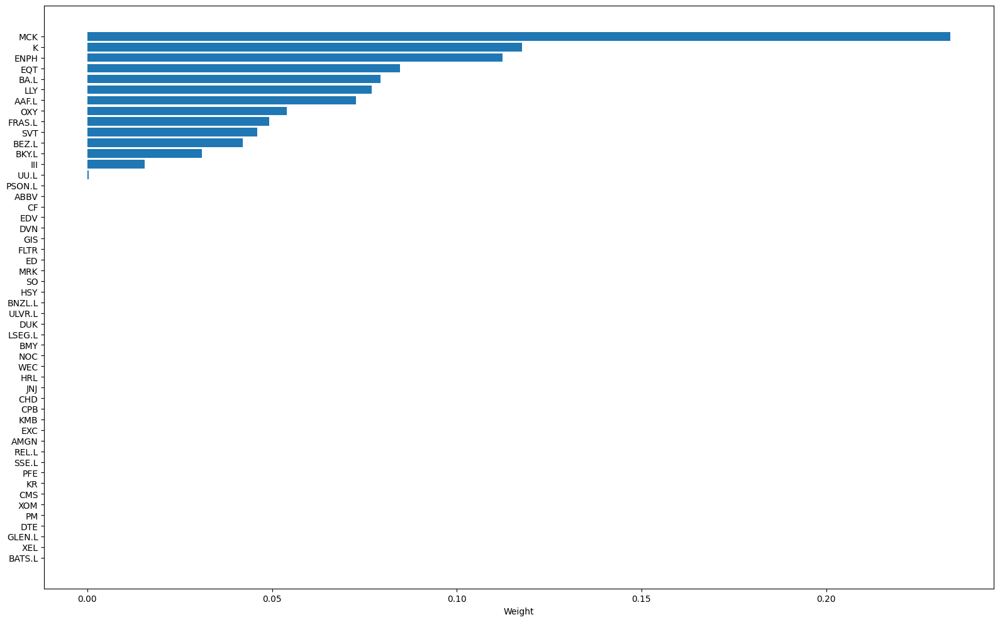

In [27]:
ef = EfficientFrontier(mu, Sigma)
raw_weights_maxsharpe_exp = ef.max_sharpe(risk_free_rate=0.09)

sorted_weights = {k: v for k, v in sorted(raw_weights_maxsharpe_exp.items(), key=lambda item: item[1], reverse=True)}
top_50_weights = dict(list(sorted_weights.items())[:50])

print(top_50_weights)
plt.figure(figsize=(16, 10))
plot_weights(top_50_weights)
max_sharpe_ret = ef.portfolio_performance(risk_free_rate=0.09)[0]
max_sharpe_vol = ef.portfolio_performance(risk_free_rate=0.09)[1]
print(max_sharpe_ret)
ef.portfolio_performance(verbose=True, risk_free_rate=0.09)

### Бектестинг

In [42]:
print(len(raw_weights_maxsharpe_exp))
print(train.shape)
print(test.shape)

582
(664, 582)
(365, 582)


In [58]:
weights_minvar_exp = list(raw_weights_minvar_exp.values())
weights_maxsharpe_exp = list(raw_weights_maxsharpe_exp.values())

ret_1 = test.dot(weights_minvar_exp).add(1).cumprod().subtract(1).multiply(100)
ret_2 = test.dot(weights_maxsharpe_exp).add(1).cumprod().subtract(1).multiply(100)
ret_cluster = test.dot(final_weights).add(1).cumprod().subtract(1).multiply(100)

In [59]:
print(ret_cluster)

Date
2022-08-01 00:00:00+00:00    -1.313938
2022-08-02 00:00:00+00:00    -0.747887
2022-08-03 00:00:00+00:00    -0.467408
2022-08-04 00:00:00+00:00     0.372257
2022-08-05 00:00:00+00:00     1.036388
                               ...    
2023-12-22 00:00:00+00:00    22.468255
2023-12-26 00:00:00+00:00    23.121631
2023-12-27 00:00:00+00:00    12.642006
2023-12-28 00:00:00+00:00     6.030507
2023-12-29 00:00:00+00:00     4.803938
Length: 365, dtype: float64


In [63]:
info = pd.DataFrame({"MinVar": ret_1, 
                     "MaxSharpe": ret_2,
                     "Clustering": ret_cluster,
                     })
info = pd.concat([info], join="outer", axis=1)
info.drop(info.tail(1).index,inplace=True)

# info.interpolate(method = "linear", inplace = True)

fig = px.line(info, x=info.index, y=info.columns, title="Portfolio Performance")
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Cumulative Return in %')

fig.show()

In [34]:
price_data['GEHC'].tail(50)

Date
2023-10-20 00:00:00+00:00    63.931194
2023-10-23 00:00:00+00:00    63.871300
2023-10-24 00:00:00+00:00    64.550034
2023-10-25 00:00:00+00:00    64.390335
2023-10-26 00:00:00+00:00    63.791447
2023-10-27 00:00:00+00:00    62.982948
2023-10-30 00:00:00+00:00    63.052818
2023-10-31 00:00:00+00:00    66.446510
2023-11-01 00:00:00+00:00    68.153336
2023-11-02 00:00:00+00:00    69.121544
2023-11-03 00:00:00+00:00    71.437241
2023-11-06 00:00:00+00:00    70.958122
2023-11-07 00:00:00+00:00    70.568848
2023-11-08 00:00:00+00:00    69.860176
2023-11-09 00:00:00+00:00    68.183273
2023-11-10 00:00:00+00:00    69.391037
2023-11-13 00:00:00+00:00    69.880135
2023-11-14 00:00:00+00:00    72.076050
2023-11-15 00:00:00+00:00    71.387321
2023-11-16 00:00:00+00:00    71.786575
2023-11-17 00:00:00+00:00    72.864586
2023-11-20 00:00:00+00:00    73.193970
2023-11-21 00:00:00+00:00    73.243874
2023-11-22 00:00:00+00:00    73.463470
2023-11-23 00:00:00+00:00    73.463470
2023-11-24 00:00:00+

In [36]:
returns['GEHC'].head(50)

Date
2020-01-03 00:00:00+00:00    0.0
2020-01-06 00:00:00+00:00    0.0
2020-01-07 00:00:00+00:00    0.0
2020-01-08 00:00:00+00:00    0.0
2020-01-09 00:00:00+00:00    0.0
2020-01-10 00:00:00+00:00    0.0
2020-01-13 00:00:00+00:00    0.0
2020-01-14 00:00:00+00:00    0.0
2020-01-15 00:00:00+00:00    0.0
2020-01-16 00:00:00+00:00    0.0
2020-01-17 00:00:00+00:00    0.0
2020-01-20 00:00:00+00:00    0.0
2020-01-21 00:00:00+00:00    0.0
2020-01-22 00:00:00+00:00    0.0
2020-01-23 00:00:00+00:00    0.0
2020-01-24 00:00:00+00:00    0.0
2020-01-27 00:00:00+00:00    0.0
2020-01-28 00:00:00+00:00    0.0
2020-01-29 00:00:00+00:00    0.0
2020-01-30 00:00:00+00:00    0.0
2020-01-31 00:00:00+00:00    0.0
2020-02-03 00:00:00+00:00    0.0
2020-02-04 00:00:00+00:00    0.0
2020-02-05 00:00:00+00:00    0.0
2020-02-06 00:00:00+00:00    0.0
2020-02-07 00:00:00+00:00    0.0
2020-02-10 00:00:00+00:00    0.0
2020-02-11 00:00:00+00:00    0.0
2020-02-12 00:00:00+00:00    0.0
2020-02-13 00:00:00+00:00    0.0
2020-